# Mask_RCNN Section

In [ ]:
import os
import sys
import random
import math
import numpy as np
import skimage.io

from matplotlib import pyplot as plt



In [ ]:
%tensorflow_version 1.x
!pip install --upgrade h5py==2.10.0
!git clone https://github.com/matterport/Mask_RCNN.git

ROOT_DIR =  'mrcnn'

import warnings
warnings.filterwarnings("ignore")

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library

from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
# Import COCO config
sys.path.append(os.path.join(ROOT_DIR, "coco.py"))  # To find local version
import coco
%matplotlib inline

TensorFlow 1.x selected.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.9 MB 31.4 MB/s 
  Attempting uninstall: h5py
    Found existing installation: h5py 3.1.0
    Uninstalling h5py-3.1.0:
      Successfully uninstalled h5py-3.1.0
Cloning into 'Mask_RCNN'...
remote: Enumerating objects: 956, done.
remote: Total 956 (delta 0), reused 0 (delta 0), pack-reused 956
Receiving objects: 100% (956/956), 125.23 MiB | 39.01 MiB/s, done.
Resolving deltas: 100% (565/565), done.


Using TensorFlow backend.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join('', "mask_rcnn_coco.h5")

# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

# Directory of images to run detection on
IMAGE_DIR = os.path.join(ROOT_DIR, "images")

... done downloading pretrained model!


In [ ]:
class InferenceConfig(coco.CocoConfig):
    # Set batch size to 1 since we'll be running inference on
    # one image at a time. Batch size = GPU_COUNT * IMAGES_PER_GPU
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

config = InferenceConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                93
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

In [ ]:
# Create model object in inference mode.
model = modellib.MaskRCNN(mode="inference", model_dir='mask_rcnn_coco.hy', config=config)

# Load weights trained on MS-COCO
model.load_weights('mask_rcnn_coco.h5', by_name=True)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.


Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Instructions for updating:
box_ind is deprecated, use box_indices instead


Instructions for updating:
Use `tf.cast` instead.


In [ ]:
class_names = ['BG', 'person', 'bicycle', 'car', 'motorcycle', 'airplane',
                'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird',
               'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear',
               'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie',
               'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
               'kite', 'baseball bat', 'baseball glove', 'skateboard',
               'surfboard',  'bottle', 'wine glass', 'cup',
               'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
               'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
               'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed',
               'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote',
               'keyboard', 'cell phone', 'microwave', 'oven', 'toaster',
               'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors',
               'teddy bear', 'hair drier', 'toothbrush']


Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32



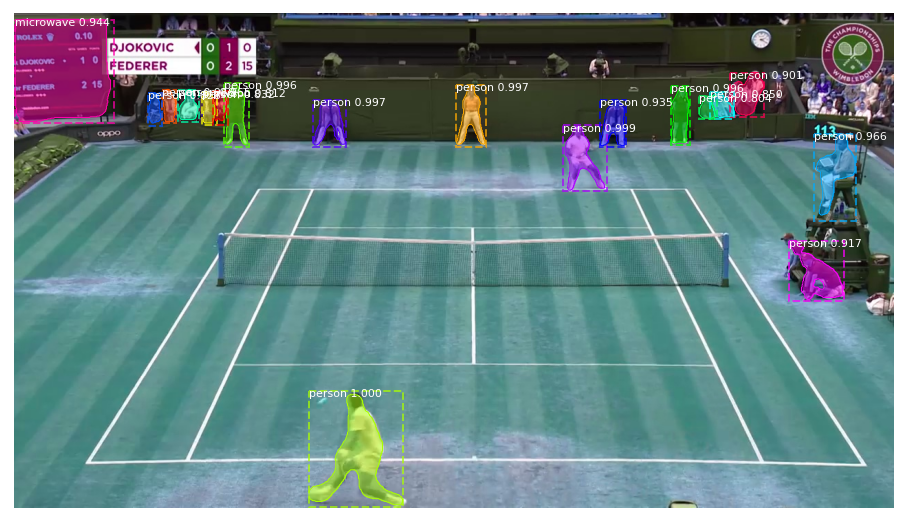

(720, 1280, 18)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


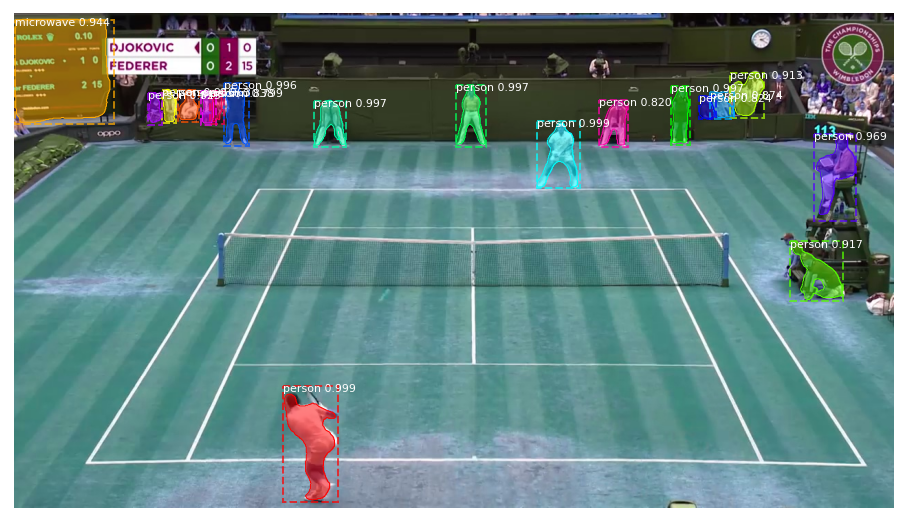

(720, 1280, 18)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


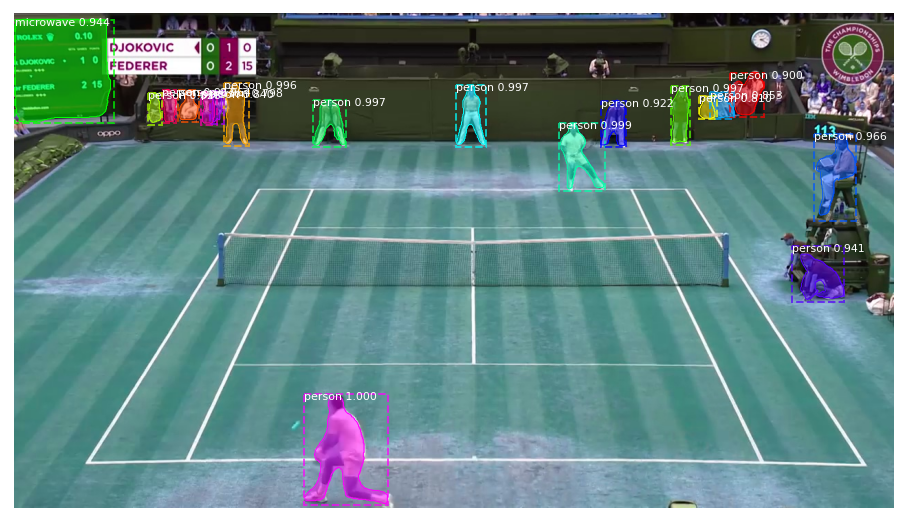

(720, 1280, 18)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


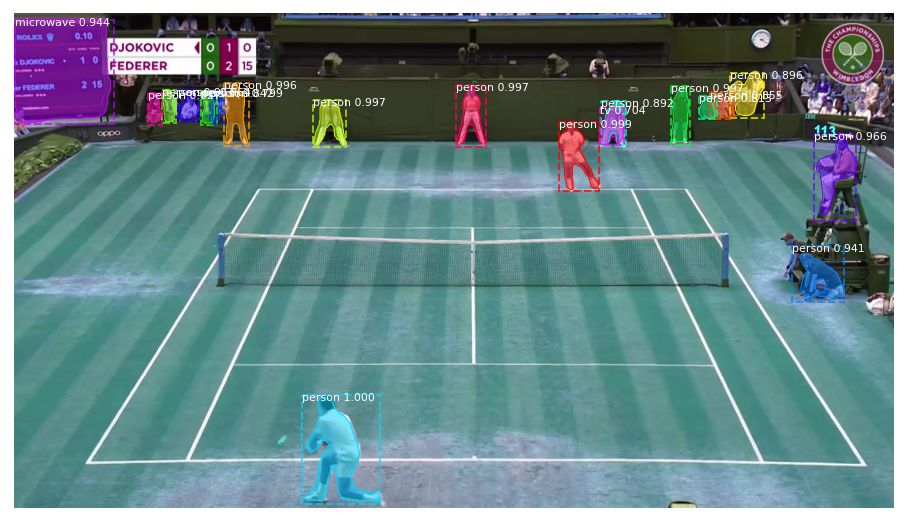

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


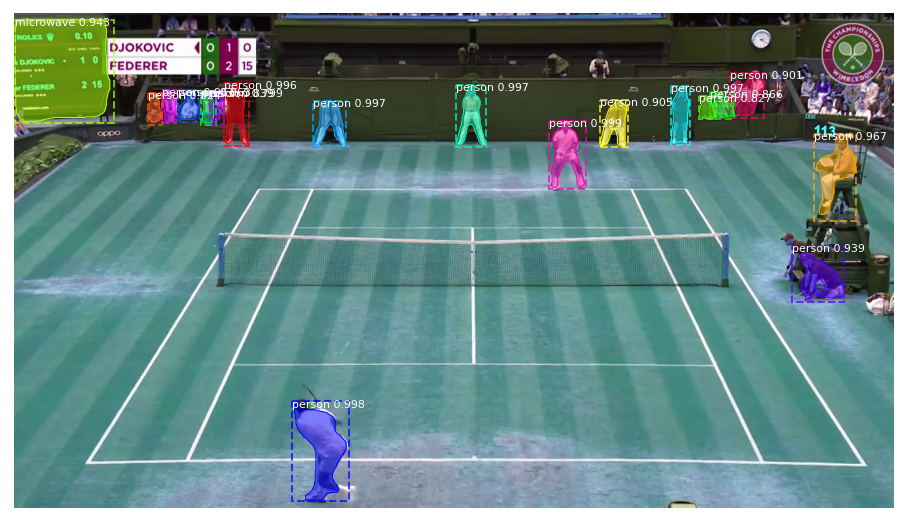

(720, 1280, 18)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


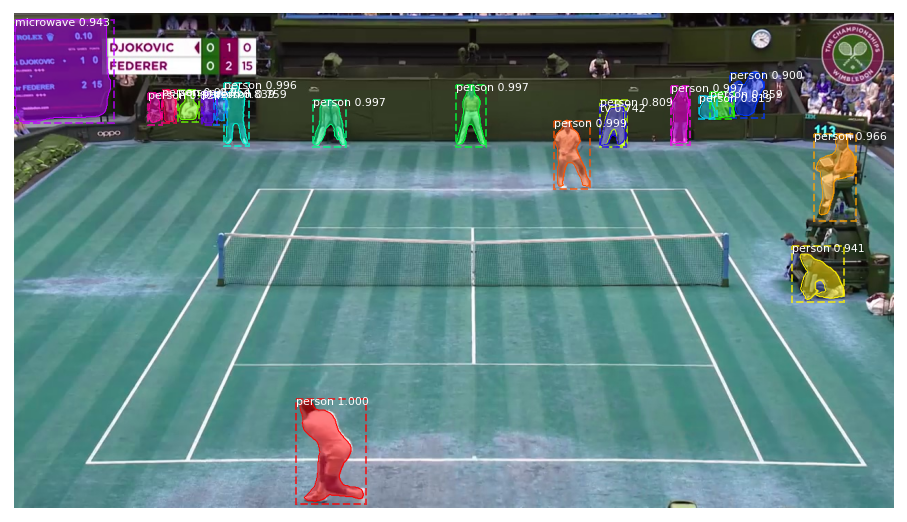

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


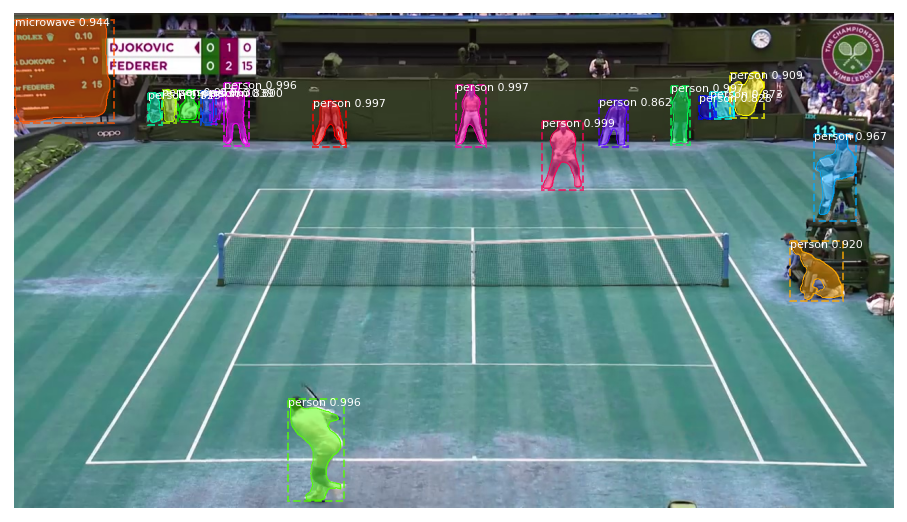

(720, 1280, 18)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


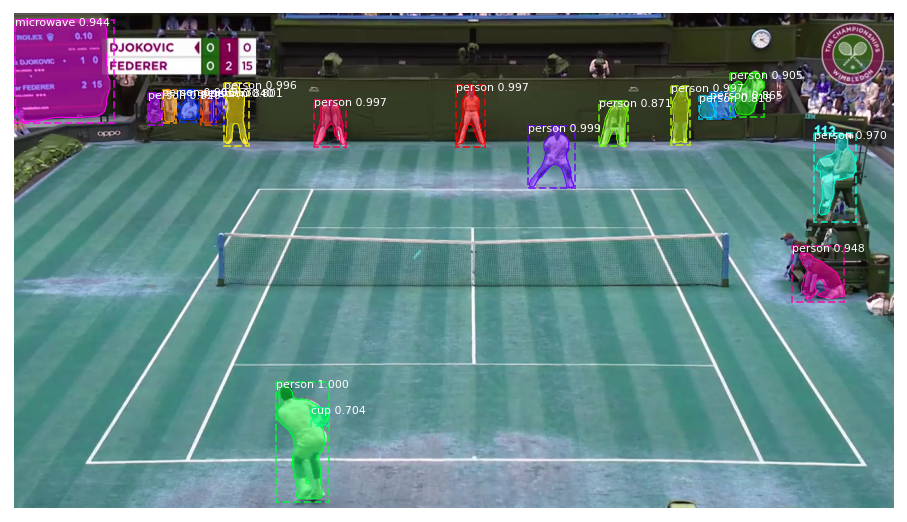

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


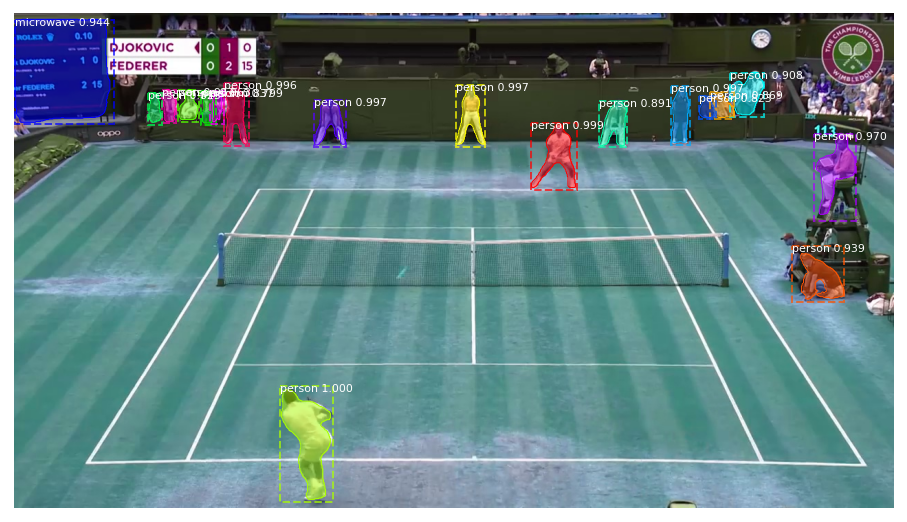

(720, 1280, 18)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


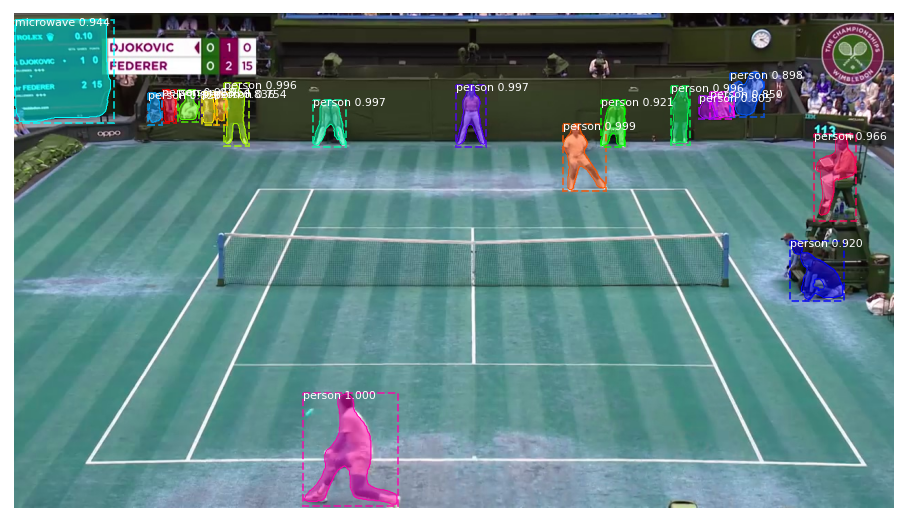

(720, 1280, 18)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


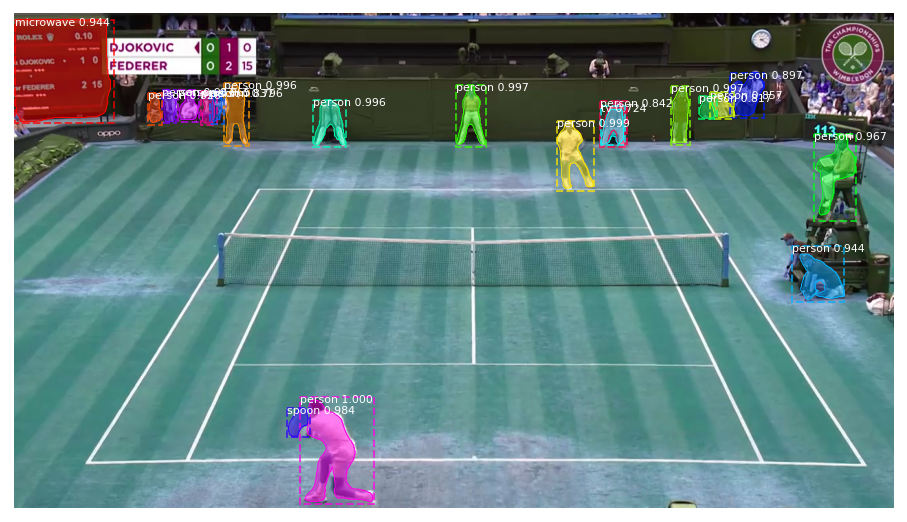

(720, 1280, 20)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


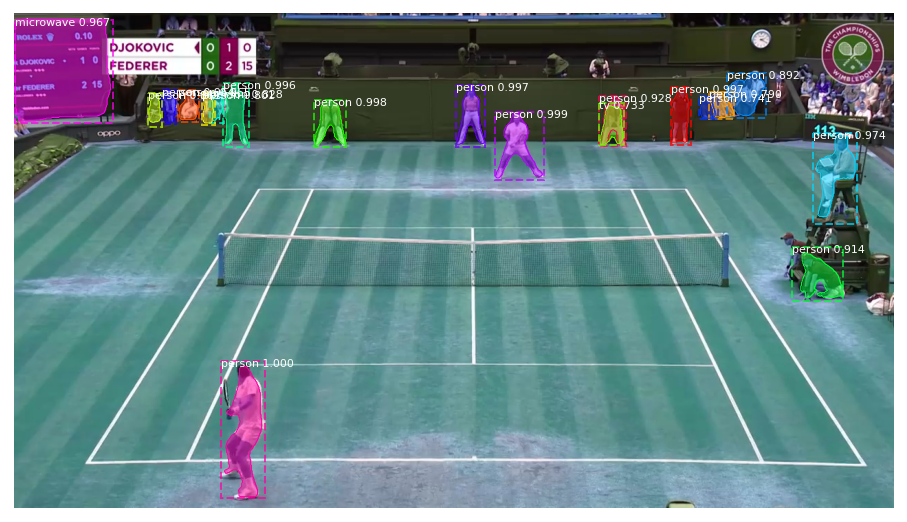

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


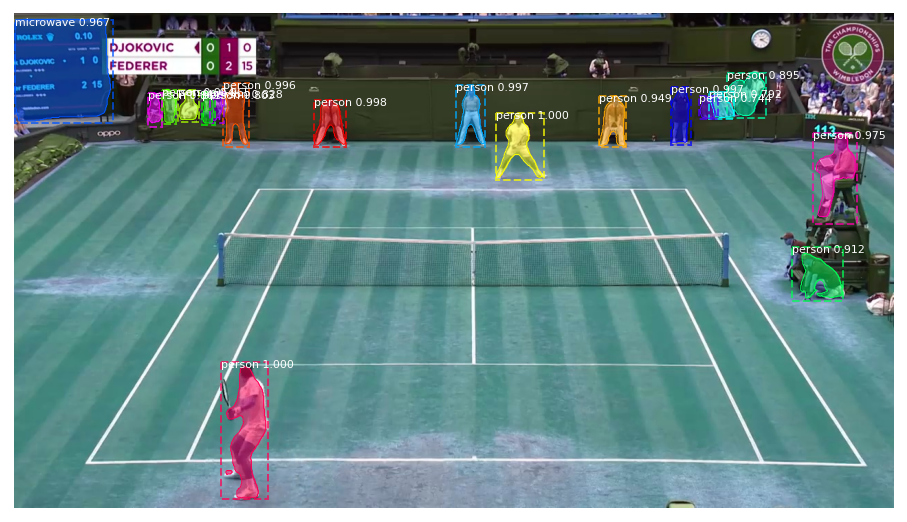

(720, 1280, 18)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


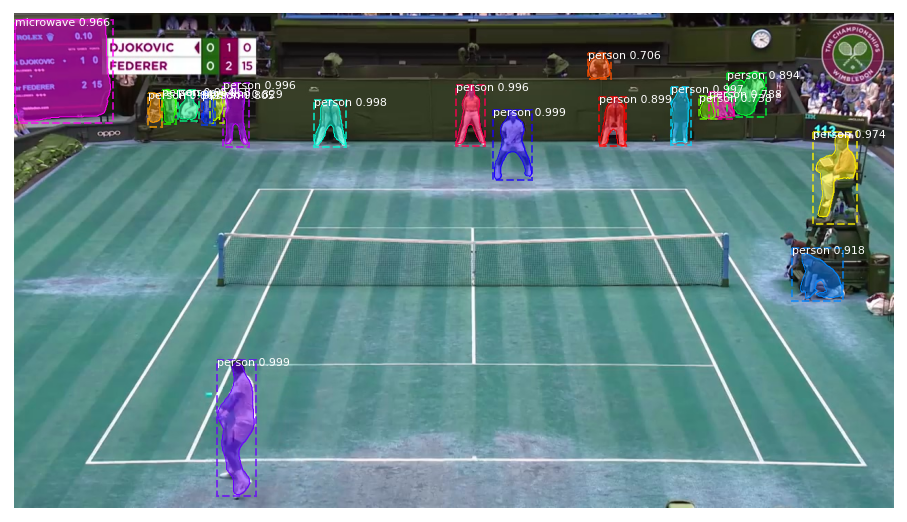

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


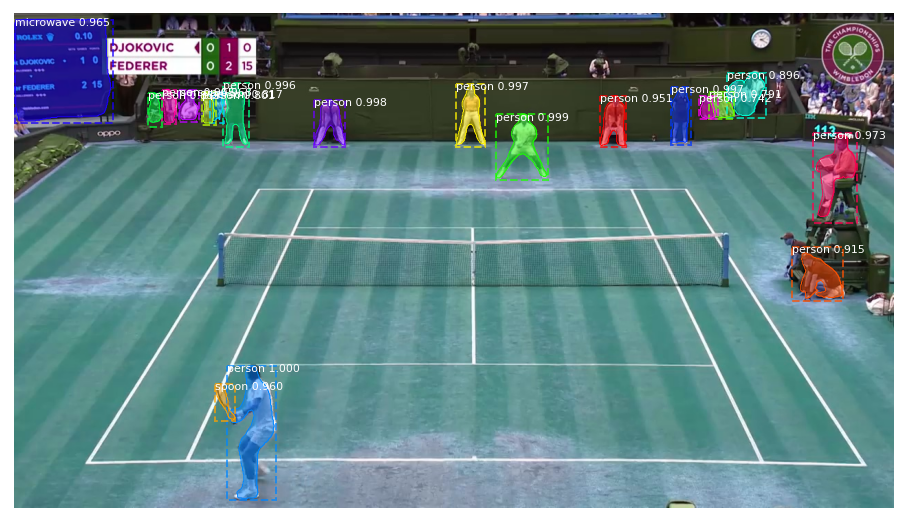

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


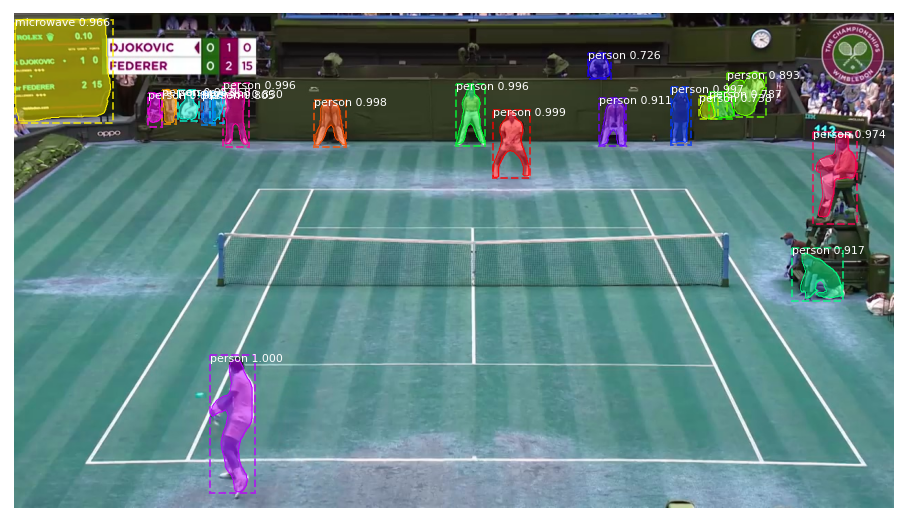

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


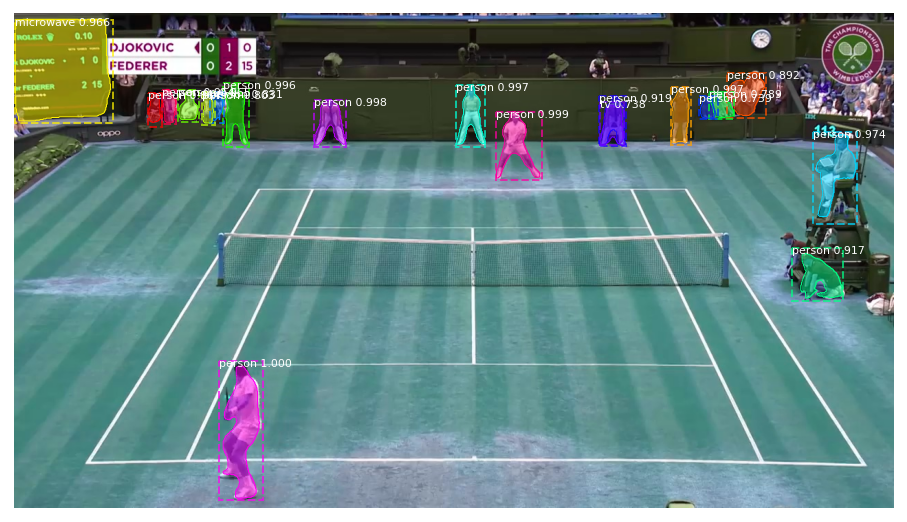

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


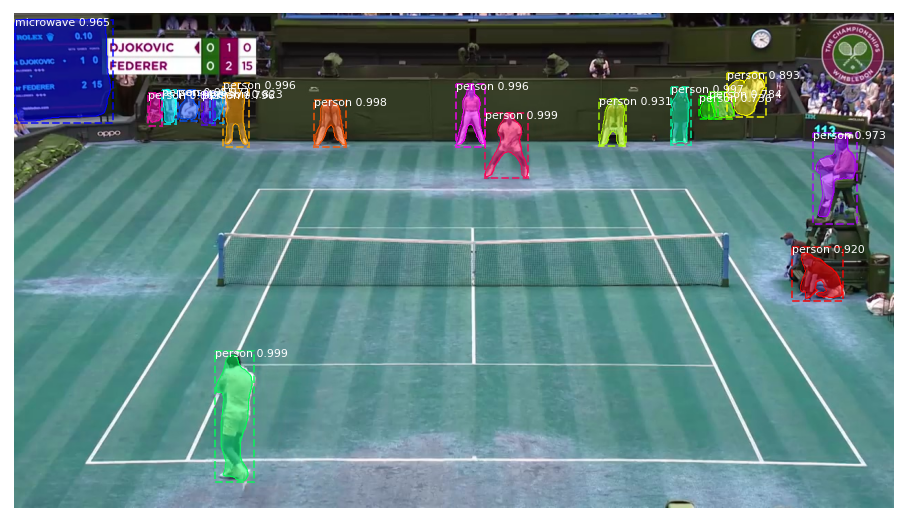

(720, 1280, 18)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


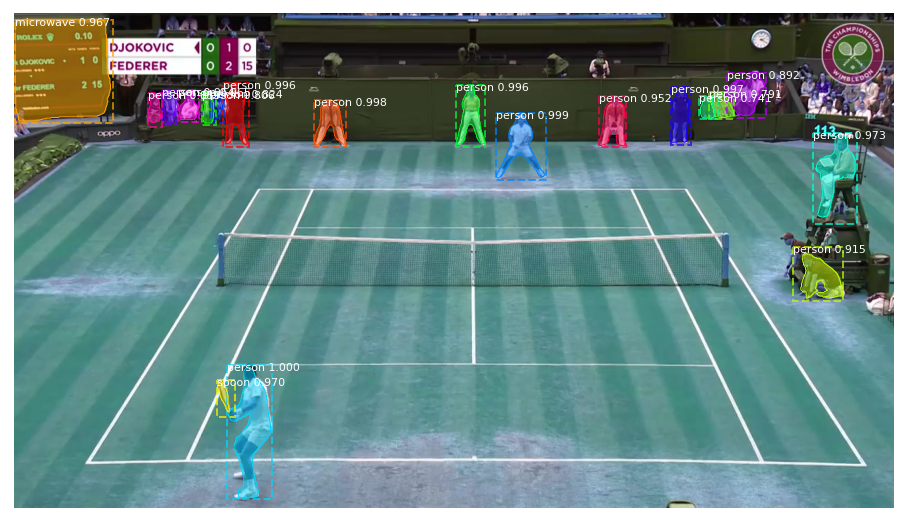

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


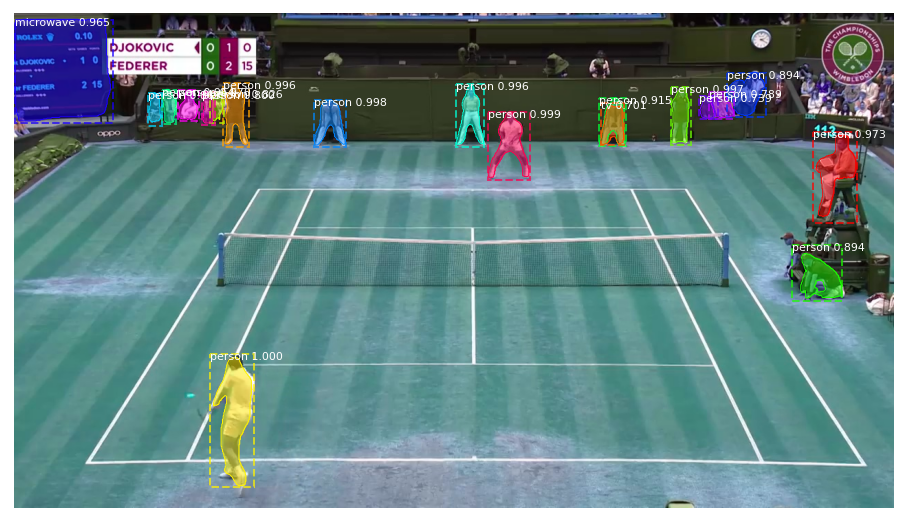

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


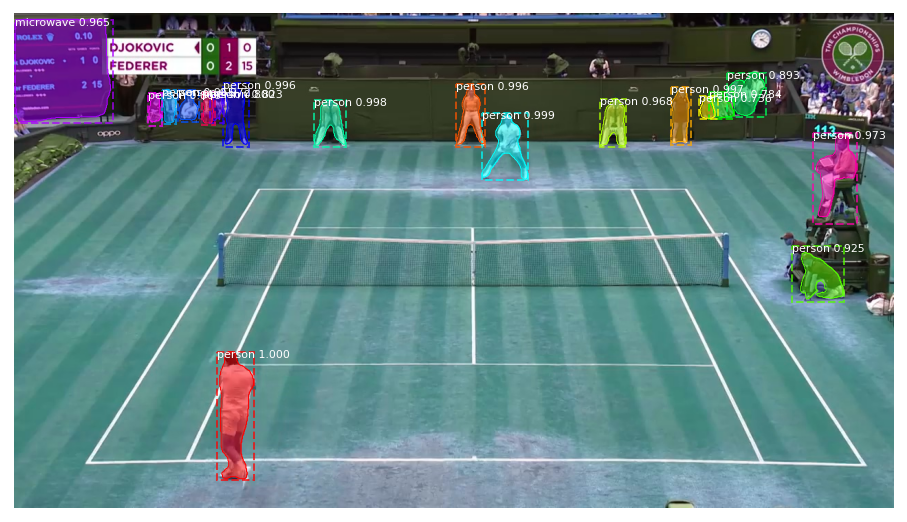

(720, 1280, 18)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


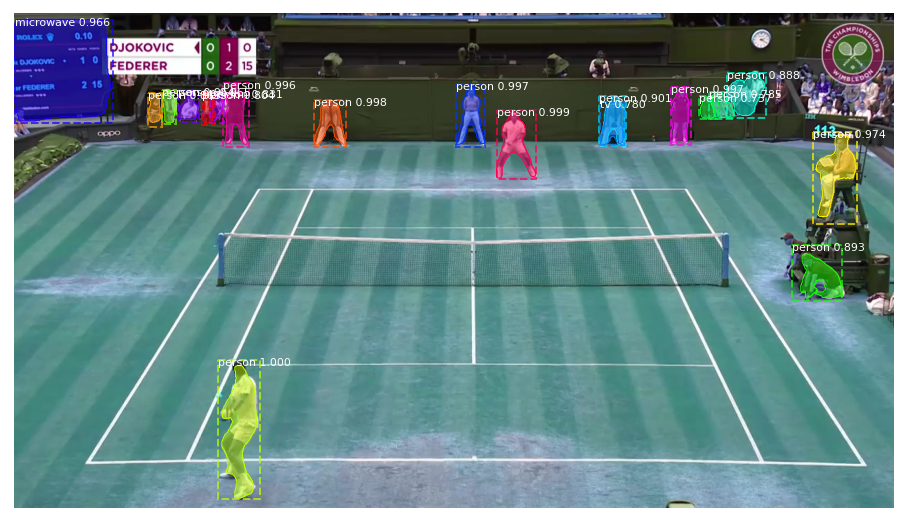

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


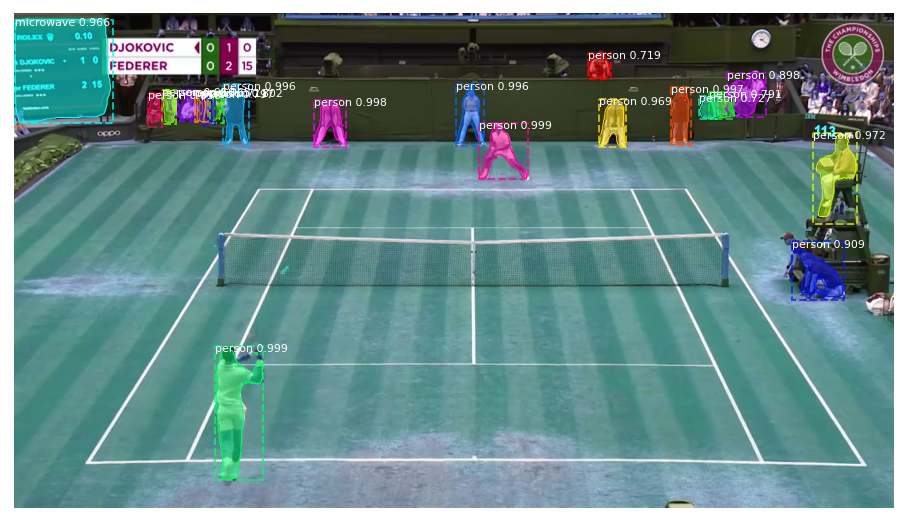

(720, 1280, 20)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


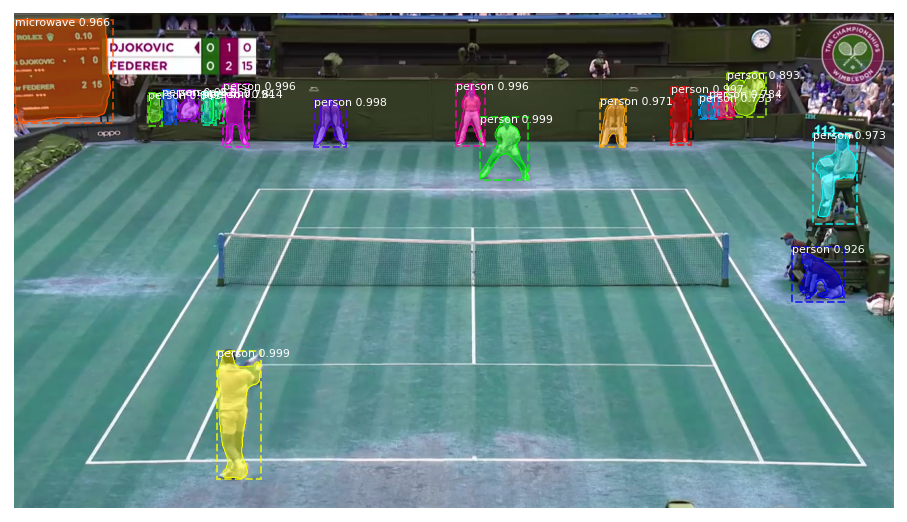

(720, 1280, 18)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


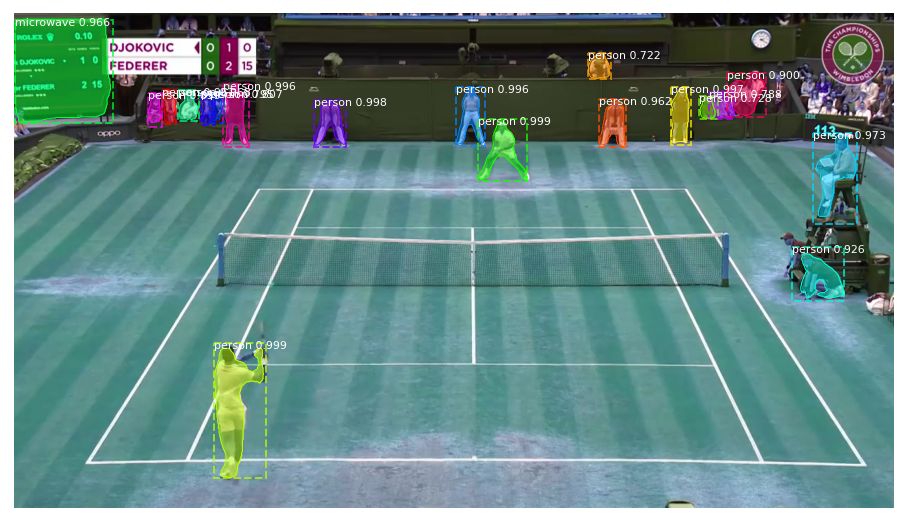

(720, 1280, 19)
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 93)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


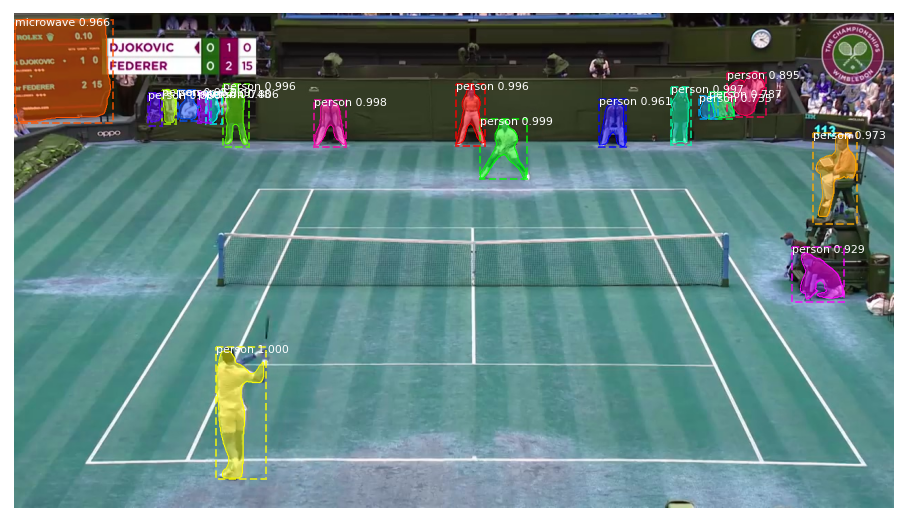

(720, 1280, 18)


In [ ]:
import cv2
import numpy as np
dataset = []
dataset2 = []
ct = 0
dataset_path = "drive/MyDrive/DataSet2"
for file_name in os.listdir(dataset_path):
       img = cv2.imread(os.path.join(dataset_path, file_name))
       results = model.detect([img], verbose=1)
       r = results[0]
       visualize.display_instances(img, r['rois'], r['masks'], r['class_ids'], class_names, r['scores'])
       mask = r['masks']
       mask = mask.astype(int)
       mask.shape
       print(mask.shape)
       rois = r['rois']
       dataset2.append(rois)
       dataset.append(mask)

# dataset = np.array(dataset)
# print (dataset.shape)

In [ ]:
RealDataSet = []
plt.figure(figsize=(8, 8))
path = "drive/MyDrive/DataSet2"
i = 0
ct = 0
for file_name in os.listdir(path):
      img = cv2.imread(os.path.join(path, file_name))
      mask = dataset[i]
      box = dataset2[i][0]
      for k in range(1):
          for j in range(img.shape[2]):
              img[:,:,j] = img[:,:,j] * mask[:,:,k]
          #plt.imshow(img[box[0]:box[2],box[1]:box[3],j])
                # fig.add_subplot(1, 2, 1)
      temp = img[box[0]:box[2],box[1]:box[3],j]
      RealDataSet.append(temp)
      i += 1

d = 1600
for n in range(len(RealDataSet)):
  filename = "images3/%d.jpg"%d
  cv2.imwrite(filename,RealDataSet[n])
  d += 1

<Figure size 576x576 with 0 Axes>

[array([[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       ...,

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ...,

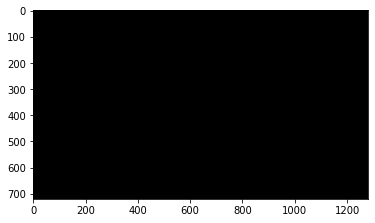

In [ ]:
i = 0
img = skimage.io.imread('drive/MyDrive/DataSet2/frame15306.jpg')
mask = dataset[1]
for k in range(2):
    for j in range(img.shape[2]):
          img[:,:,j] = img[:,:,j] * mask[:,:,k]
    plt.imshow(img)



In [ ]:
  from google.colab import files
!zip -r /content/images3.zip /content/images3
files.download('/content/images3.zip')


  adding: content/images3/ (stored 0%)
  adding: content/images3/1605.jpg (deflated 1%)
  adding: content/images3/1611.jpg (deflated 0%)
  adding: content/images3/1612.jpg (deflated 0%)
  adding: content/images3/1625.jpg (stored 0%)
  adding: content/images3/1608.jpg (deflated 0%)
  adding: content/images3/1614.jpg (deflated 0%)
  adding: content/images3/1606.jpg (deflated 1%)
  adding: content/images3/1620.jpg (deflated 0%)
  adding: content/images3/1618.jpg (deflated 0%)
  adding: content/images3/1609.jpg (deflated 0%)
  adding: content/images3/1600.jpg (stored 0%)
  adding: content/images3/1621.jpg (deflated 0%)
  adding: content/images3/1619.jpg (deflated 0%)
  adding: content/images3/1603.jpg (deflated 1%)
  adding: content/images3/1616.jpg (deflated 0%)
  adding: content/images3/1615.jpg (deflated 1%)
  adding: content/images3/1613.jpg (deflated 0%)
  adding: content/images3/1610.jpg (stored 0%)
  adding: content/images3/1602.jpg (deflated 1%)
  adding: content/images3/1622.jpg (

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

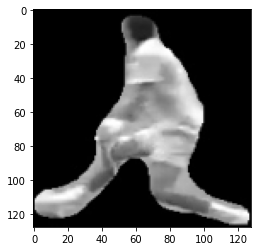

In [ ]:
img = cv2.imread('/content/images3/1600.jpg')
image = cv2.resize(img, (128,128), interpolation = cv2.INTER_AREA)
image=np.array(image)
plt.imshow(image)

(192, 68)
(93, 70)
(93, 19)
(257, 141)
(222, 101)
(90, 70)
(100, 61)
(212, 73)
(65, 19)
(210, 108)
(73, 37)
(92, 54)
(220, 134)
(173, 73)
(101, 52)
(72, 50)
(204, 77)
(107, 53)
(188, 95)
(92, 47)
(72, 27)
(65, 46)
(202, 96)
(92, 52)
(72, 25)
(179, 113)
(93, 49)
(71, 26)
(51, 22)
(201, 68)
(88, 54)
(71, 25)
(202, 82)
(89, 53)
(71, 25)
(198, 80)
(92, 48)
(72, 26)
(38, 22)
(165, 113)
(92, 68)
(65, 44)
(219, 145)
(144, 94)
(94, 41)
(65, 44)
(219, 145)
(161, 109)
(88, 60)
(65, 44)
(219, 145)
(153, 106)
(100, 56)
(65, 44)
(219, 145)
(141, 103)
(100, 42)
(65, 44)
(219, 145)
(150, 97)
(98, 45)
(65, 44)
(219, 145)
(140, 113)
(101, 49)
(65, 44)
(219, 145)
(186, 59)
(68, 48)
(208, 129)
(195, 74)
(93, 52)
(68, 48)
(208, 130)
(190, 73)
(92, 53)
(68, 48)
(208, 129)
(62, 36)
(193, 63)
(68, 48)
(92, 54)
(208, 129)
(81, 48)
(163, 76)
(73, 26)
(212, 137)
(77, 45)
(168, 80)
(73, 26)
(212, 137)
(171, 80)
(75, 46)
(73, 26)
(214, 139)
(164, 82)
(74, 26)
(214, 139)
(76, 47)
(142, 63)
(75, 28)
(209, 136)
(144

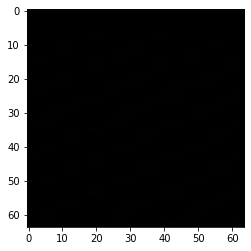

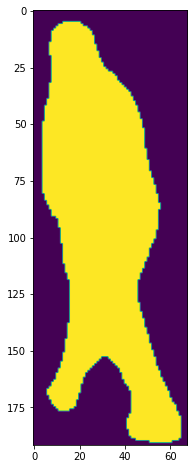

In [ ]:
from re import I
import PIL
from PIL import Image
from numpy import asarray
import cv2

DataSet3 = []
TempDataSet = []
length1 = len(dataset)
for i in range(length1):
  tmsk = dataset[i]
  for k in range(tmsk.shape[2]):
    box = dataset2[i][k]
    tmp = tmsk[box[0]:box[2],box[1]:box[3], k]
    if box[0] >= 115 and box[0] <= 690:
      #tmp = np.resize(tmp,(200,80))
      #image = cv2.cvtColor(tmp, cv2.COLOR_BGR2RGB)
      print(tmp.shape)
      plt.imshow(image)
      DataSet3.append(tmp)
      TempDataSet.append(box)

#print ('>> ', DataSet3[0].shape )
length = len(DataSet3)
leng = len(TempDataSet)
i = 0
while i < 1:
    tm = DataSet3[i]
    plt.figure(figsize=(8,8))
    plt.imshow(tm)
    i = i + 1

# print(len(DataSet3))

[471 722 663 790]
[116 428 209 498]
[ 80 961 168 991]
[101 324 175 365]
[ 74 295 168 328]
[ 96 630 170 682]
[540 719 633 738]
[ 84 190 133 223]
[  52 1047  150 1086]
[  88 1029  132 1052]
[  89  997  129 1014]
[ 92 220 141 260]
[  6 268  70 299]
[ 137 1096  394 1237]
[ 94 832 169 879]
[  89  984  164 1009]
[100 834 167 879]
[ 20 202  65 252]


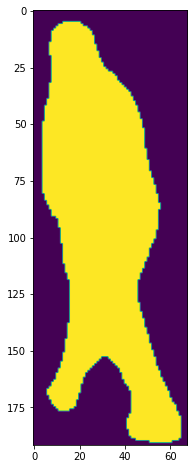

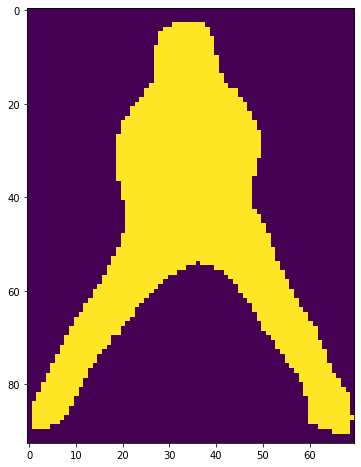

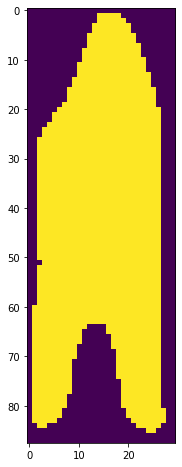

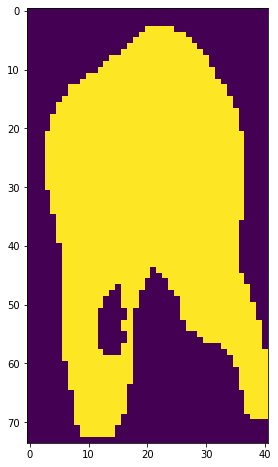

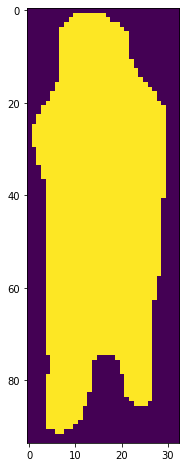

...

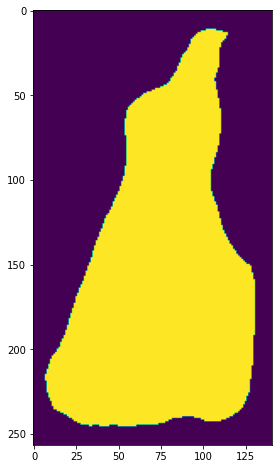

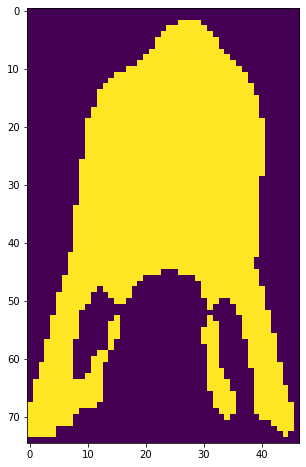

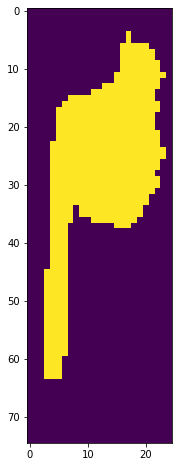

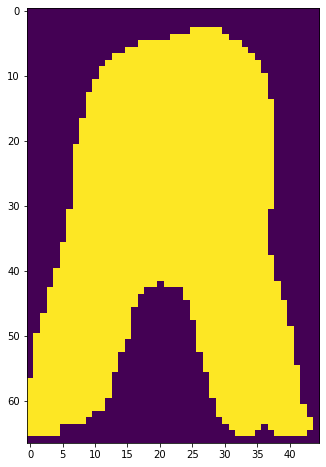

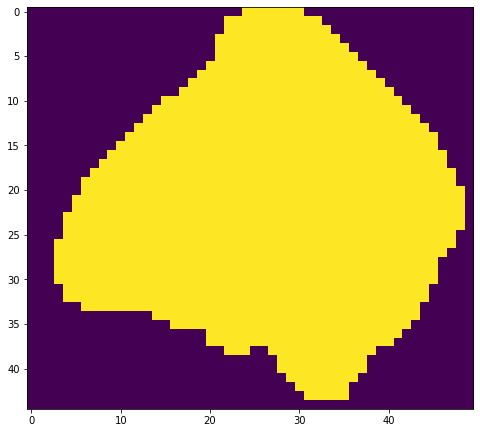

In [ ]:
# # Run detection
# results = model.detect([image], verbose=1)

# # Visualize results
# r = results[0]
# visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], class_names, r['scores'])
# arow = len(dataset)
# acol = len(dataset[1])
# print("Rows : " + str(arow))
# print("Columns : " + str(acol))
# print (dataset.shape)
for i in range(1):
#for i in range(len(dataset)):
  #print (dataset[i].shape)
  for k in range(dataset[i].shape[2]):
    msk = dataset[i]
    #print (msk.shape)
    box = dataset2[i][k]
    #print (box.shape)
    print (box)
    msk.resize()
    tmp = msk[box[0]:box[2],box[1]:box[3], k]
    #y1, x1, y2, x2
    #print ('>>' , m)
    plt.figure(figsize=(8,8))
    #plt.imshow(msk[:, :, k])
    plt.imshow(tmp)


# CNN Model


In [ ]:
import tensorflow as tf
import keras
from keras.models import Sequential
from keras.layers import Convolution2D
from keras.layers import MaxPooling2D
from keras.layers import Flatten
from keras.layers import Dense
from keras.preprocessing.image import ImageDataGenerator
from keras.utils.np_utils import to_categorical
from tensorflow.keras.preprocessing import image_dataset_from_directory

In [ ]:
batchdata = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg16.preprocess_input)\
.flow_from_directory()

TypeError: ignored

In [ ]:
cnn = Sequential()

In [ ]:
cnn.add(Convolution2D(64, 3, 3, input_shape = (128, 128, 3), activation = 'relu'))

In [ ]:
cnn.add(MaxPooling2D(pool_size = (2, 2)))

In [ ]:
cnn.add(Flatten())

In [ ]:
cnn.add(Dense(128, activation = 'relu'))
cnn.add(Dense(1, activation = 'sigmoid'))

In [ ]:
cnn.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])

In [ ]:
train_ds = tf.keras.utils.image_dataset_from_directory(
    'Train_Set',
    labels="inferred",
    label_mode="int",
    class_names=None,
    color_mode="rgb",
    batch_size=32,
    image_size=(256, 256),
    shuffle=True,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation="bilinear",
    follow_links=False,
    crop_to_aspect_ratio=False,
    **kwargs
)

NameError: ignored

In [ ]:
test_datagen = ImageDataGenerator(rescale = 1./255)
test_set = test_datagen.flow_from_directory('Test_Set',
                                            target_size = (64, 64),
                                            batch_size = 32,
                                            class_mode = 'binary')

Found 0 images belonging to 0 classes.
